In [1]:
FN = 'train'
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


# install packages

In [2]:
!pip install lime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 275 kB 24.3 MB/s 
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283857 sha256=b08f3aef9431e8e47ab2d46b85a05901f8ae4e870ab6c0a6e1405beb6c0102e2
  Stored in directory: /root/.cache/pip/wheels/ca/cb/e5/ac701e12d365a08917bf4c6171c0961bc880a8181359c66aa7
Successfully built lime


In [3]:
!pip install datasets

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 365 kB 33.7 MB/s 
     |████████████████████████████████| 212 kB 52.1 MB/s 
     |████████████████████████████████| 115 kB 59.4 MB/s 
     |████████████████████████████████| 101 kB 11.3 MB/s 
     |████████████████████████████████| 127 kB 79.2 MB/s 
  Attempting uninstall: urllib3
    Found existing installation: urllib3 1.24.3
    Uninstalling urllib3-1.24.3:
      Successfully uninstalled urllib3-1.24.3


In [4]:
!pip install transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 4.7 MB 28.5 MB/s 
     |████████████████████████████████| 6.6 MB 53.0 MB/s 


In [5]:
!pip install bertviz

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 157 kB 27.1 MB/s 
     |████████████████████████████████| 1.3 MB 43.3 MB/s 
     |████████████████████████████████| 132 kB 62.1 MB/s 
     |████████████████████████████████| 9.1 MB 64.8 MB/s 
     |████████████████████████████████| 79 kB 9.4 MB/s 


In [6]:
!pip install shap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 569 kB 29.0 MB/s 


# import modules

In [7]:
import keras
from PIL import Image
import numpy as np
import pandas as pd
import tensorflow as tf
import regex as re
from keras_preprocessing.sequence import pad_sequences
import pickle
from bertviz import model_view, head_view
import torch
import lime
from lime.lime_text import LimeTextExplainer
import tensorflow as tf
import tensorflow_datasets as tfds
from tensorboard.plugins import projector
from sklearn.pipeline import make_pipeline
import nltk
from nltk.tokenize import RegexpTokenizer
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.stem.snowball import SnowballStemmer
from shap.plots import colors
import matplotlib
import shap
shap.initjs()
from shap.plots import colors
from matplotlib import pyplot as plt
%matplotlib inline
try:
    %tensorflow_version 2.x
except Exception:
    pass

%load_ext tensorboard

from transformers import AutoTokenizer
from transformers import TFAutoModelForSeq2SeqLM

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


In [8]:
with open('gdrive/My Drive/CAPSTONE/global_data/word_occ_df', 'rb') as fp:
    art_occ_df=pickle.load(fp)


In [9]:
with open('gdrive/My Drive/CAPSTONE/global_data/tweet_viral_df', 'rb') as fp:
    tweet_occ_df = pickle.load(fp)

In [10]:
tweet_occ_df.rename(columns={'date':'year'}, inplace=True)

# helper functions

In [11]:
stopwords_list = stopwords.words('english')
basic_token_pattern = r"(?u)\b\w\w+\b"
tokenizer = RegexpTokenizer(basic_token_pattern)
stemmer = SnowballStemmer(language="english")

def stem_and_tokenize(document):
    '''takes in document, stems and tokenises'''
    tokens = tokenizer.tokenize(document)
    return [stemmer.stem(token) for token in tokens]

def remove_stopwords(token_list):
    '''takes in tokenised list and removes stop words'''
    stopwords_removed = [token for token in token_list if token not in stopwords_list]
    return stopwords_removed

# api class

In [12]:
class ArticleAnalyser:

  def __init__(self, article):
    tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)
    self.headline_model=TFAutoModelForSeq2SeqLM.from_pretrained("t5-small", output_attentions=True)
    self.headline_model.load_weights("gdrive/My Drive/CAPSTONE/summarizer/T5/model")

    self.tweet_model=TFAutoModelForSeq2SeqLM.from_pretrained("t5-small", output_attentions=True)
    self.tweet_model.load_weights("gdrive/My Drive/CAPSTONE/summarizer/tweet_summarizer/model")

    self.bert_tokenizer = AutoTokenizer.from_pretrained("t5-small")
    self.article=article

    with open('gdrive/My Drive/CAPSTONE/global_data/tweet_viral_tfid_vector', 'rb') as fp:
      self.tweet_fitted_tfid = pickle.load(fp)

    self.tweet=''

  def opinion_news_score(self):
    with open('gdrive/My Drive/CAPSTONE/global_data/opinion_news_pipeline', 'rb') as fp:
      self.on_pipeline=pickle.load(fp)
    article=[self.article.lower()]
    self.opinion_score= self.on_pipeline.predict_proba(article)[:,1]
    print(f'Opinion Score = {round(float((self.opinion_score*100)[0]),2)} percent')



  def generate_headline(self, model_type='headline'):
    if model_type=='headline':
      model=self.headline_model
    elif model_type=='tweet':
      model=self.tweet_model
    encoder_input_ids=self.bert_tokenizer(self.article, max_length=40, truncation=True, padding='max_length', return_tensors="tf").input_ids
    decoder_input_ids = model.generate(encoder_input_ids)  
    res= self.bert_tokenizer.convert_ids_to_tokens(decoder_input_ids[0])
    self.pred_seq = self.bert_tokenizer.convert_tokens_to_string(res[3:])

    outputs = model(input_ids=encoder_input_ids, decoder_input_ids=decoder_input_ids)
    encoder_text = self.bert_tokenizer.convert_ids_to_tokens(encoder_input_ids[0])
    decoder_text = res

    encoder_attention_py=()
    decoder_attention_py=()
    cross_attention_py=()

    for tensor in outputs.encoder_attentions:
      nump=tensor.numpy()
      py = torch.from_numpy(nump)
      encoder_attention_py=encoder_attention_py + (py,)

    for tensor in outputs.decoder_attentions:
      nump=tensor.numpy()
      py = torch.from_numpy(nump)
      decoder_attention_py=decoder_attention_py + (py,)

    for tensor in outputs.cross_attentions:
      nump=tensor.numpy()
      py = torch.from_numpy(nump)
      cross_attention_py=cross_attention_py + (py,)
    
    print(f'Predicted {model_type} = {self.pred_seq}')

    if model_type=='tweet':
      self.tweet=self.pred_seq

    head_view(encoder_attention=encoder_attention_py,
              decoder_attention=decoder_attention_py,
              cross_attention=cross_attention_py,
              encoder_tokens= encoder_text,
              decoder_tokens = decoder_text)

  def generate_tweet(self):
    self.generate_headline(model_type='tweet')
      

  def predict_tweet_virality(self):
    if self.tweet=='':
      print('use generate_tweet method to generate the tweet')
      return None

    with open('gdrive/My Drive/CAPSTONE/global_data/tweet_viral_pipeline', 'rb') as fp:
      self.tv_pipeline=pickle.load(fp)
    tweet=[self.tweet.lower()]
    self.tweet_virality= self.tv_pipeline.predict(tweet)
    virality_dic={'0':'no play', '1':'below_par', '2': 'average', '3': 'above par', '4':'viral'}
    print(f'Virality = {virality_dic[self.tweet_virality[0]]}')

  def lime_vizualizer(self, inp, pipeline, labels_nn):
    '''helper function for lime vizualisations'''
    explainer = LimeTextExplainer(class_names=labels_nn)
    exp = explainer.explain_instance(inp, pipeline.predict_proba, num_features=6, top_labels=1)
    exp.show_in_notebook(text=False)


  def format_value(self, s, format_str):
      """ Strips trailing zeros and uses a unicode minus sign.
      """

      if not issubclass(type(s), str):
          s = format_str % s
      s = re.sub(r'\.?0+$', '', s)
      if s[0] == "-":
          s = u"\u2212" + s[1:]
      return s

  def waterfall(self, shap_values, max_display=10, show=True):
      '''This method and format_value are exact copies from the plot.waterfall.py file
      in the shap module. There is a glitch when displaying the feature names when called
      direct from the module, so I copied it over and made the change (easier to debug)'''

      feature_names = self.shap_val.feature_names
      if show is False:
          plt.ioff()

      base_values = shap_values.base_values
      features = shap_values.display_data if shap_values.display_data is not None else shap_values.data
      lower_bounds = getattr(shap_values, "lower_bounds", None)
      upper_bounds = getattr(shap_values, "upper_bounds", None)
      values = shap_values.values

      # make sure we only have a single output to explain
      if (type(base_values) == np.ndarray and len(base_values) > 0) or type(base_values) == list:
          raise Exception("waterfall_plot requires a scalar base_values of the model output as the first "
                          "parameter, but you have passed an array as the first parameter! "
                          "Try shap.waterfall_plot(explainer.base_values[0], values[0], X[0]) or "
                          "for multi-output models try "
                          "shap.waterfall_plot(explainer.base_values[0], values[0][0], X[0]).")

      # make sure we only have a single explanation to plot
      if len(values.shape) == 2:
          raise Exception(
              "The waterfall_plot can currently only plot a single explanation but a matrix of explanations was passed!")

      # init variables we use for tracking the plot locations
      num_features = min(max_display, len(values))
      row_height = 0.5
      rng = range(num_features - 1, -1, -1)
      order = np.argsort(-np.abs(values))
      pos_lefts = []
      pos_inds = []
      pos_widths = []
      pos_low = []
      pos_high = []
      neg_lefts = []
      neg_inds = []
      neg_widths = []
      neg_low = []
      neg_high = []
      loc = base_values + values.sum()
      yticklabels = ["" for i in range(num_features + 1)]

      # size the plot based on how many features we are plotting
      plt.gcf().set_size_inches(8, num_features * row_height + 1.5)

      # see how many individual (vs. grouped at the end) features we are plotting
      if num_features == len(values):
          num_individual = num_features
      else:
          num_individual = num_features - 1

      # compute the locations of the individual features and plot the dashed connecting lines
      for i in range(num_individual):
          sval = values[order[i]]
          loc -= sval
          if sval >= 0:
              pos_inds.append(rng[i])
              pos_widths.append(sval)
              if lower_bounds is not None:
                  pos_low.append(lower_bounds[order[i]])
                  pos_high.append(upper_bounds[order[i]])
              pos_lefts.append(loc)
          else:
              neg_inds.append(rng[i])
              neg_widths.append(sval)
              if lower_bounds is not None:
                  neg_low.append(lower_bounds[order[i]])
                  neg_high.append(upper_bounds[order[i]])
              neg_lefts.append(loc)
          if num_individual != num_features or i + 4 < num_individual:
              plt.plot([loc, loc], [rng[i] - 1 - 0.4, rng[i] + 0.4],
                      color="#bbbbbb", linestyle="--", linewidth=0.5, zorder=-1)
          if features is None:
              yticklabels[rng[i]] = feature_names[order[i]]
          else:
              if np.issubdtype(type(features[order[i]]), np.number):
                  yticklabels[rng[i]] = self.format_value(float(features[order[i]]), "%0.03f") + " = " + feature_names[order[i]]
              else:
                  yticklabels[rng[i]] = features[order[i]] + " = " + feature_names[order[i]]
      # add a last grouped feature to represent the impact of all the features we didn't show
      if num_features < len(values):
          yticklabels[0] = "%d other features" % (len(values) - num_features + 1)
          remaining_impact = base_values - loc
          if remaining_impact < 0:
              pos_inds.append(0)
              pos_widths.append(-remaining_impact)
              pos_lefts.append(loc + remaining_impact)
              c = colors.red_rgb
          else:
              neg_inds.append(0)
              neg_widths.append(-remaining_impact)
              neg_lefts.append(loc + remaining_impact)
              c = colors.blue_rgb

      print('Red pointers indicate word that suggest an opinion piece. The bigger the pointer, the more indicative it is of an opinion piece.')
      print('Blue pointers indicate word that suggest a news piece. The bigger the pointer, the more indicative the word is of a news piece.')
      print('Working from the bottom up, the plot shows how much each word influences the final prediction score.')
      print('Negative numbers suggest news pieces, positive numbers opinion pieces, so a final negative score suggests a news piece.')

      points = pos_lefts + list(np.array(pos_lefts) + np.array(pos_widths)) + neg_lefts + \
          list(np.array(neg_lefts) + np.array(neg_widths))
      dataw = np.max(points) - np.min(points)

      # draw invisible bars just for sizing the axes
      label_padding = np.array([0.1*dataw if w < 1 else 0 for w in pos_widths])
      plt.barh(pos_inds, np.array(pos_widths) + label_padding + 0.02*dataw,
              left=np.array(pos_lefts) - 0.01*dataw, color=colors.red_rgb, alpha=0)
      label_padding = np.array([-0.1*dataw if -w < 1 else 0 for w in neg_widths])
      plt.barh(neg_inds, np.array(neg_widths) + label_padding - 0.02*dataw,
              left=np.array(neg_lefts) + 0.01*dataw, color=colors.blue_rgb, alpha=0)

      # define variable we need for plotting the arrows
      head_length = 0.08
      bar_width = 0.8
      xlen = plt.xlim()[1] - plt.xlim()[0]
      fig = plt.gcf()
      ax = plt.gca()
      xticks = ax.get_xticks()
      bbox = ax.get_window_extent().transformed(fig.dpi_scale_trans.inverted())
      width, height = bbox.width, bbox.height
      bbox_to_xscale = xlen/width
      hl_scaled = bbox_to_xscale * head_length
      renderer = fig.canvas.get_renderer()

      # draw the positive arrows
      for i in range(len(pos_inds)):
          dist = pos_widths[i]
          arrow_obj = plt.arrow(
              pos_lefts[i], pos_inds[i], max(dist-hl_scaled, 0.000001), 0,
              head_length=min(dist, hl_scaled),
              color=colors.red_rgb, width=bar_width,
              head_width=bar_width
          )

          if pos_low is not None and i < len(pos_low):
              plt.errorbar(
                  pos_lefts[i] + pos_widths[i], pos_inds[i],
                  xerr=np.array([[pos_widths[i] - pos_low[i]], [pos_high[i] - pos_widths[i]]]),
                  ecolor=colors.light_red_rgb
              )

          txt_obj = plt.text(
              pos_lefts[i] + 0.5*dist, pos_inds[i], self.format_value(pos_widths[i], '%+0.02f'),
              horizontalalignment='center', verticalalignment='center', color="white",
              fontsize=12
          )
          text_bbox = txt_obj.get_window_extent(renderer=renderer)
          arrow_bbox = arrow_obj.get_window_extent(renderer=renderer)

          # if the text overflows the arrow then draw it after the arrow
          if text_bbox.width > arrow_bbox.width:
              txt_obj.remove()

              txt_obj = plt.text(
                  pos_lefts[i] + (5/72)*bbox_to_xscale + dist, pos_inds[i], self.format_value(pos_widths[i], '%+0.02f'),
                  horizontalalignment='left', verticalalignment='center', color=colors.red_rgb,
                  fontsize=12
              )

      # draw the negative arrows
      for i in range(len(neg_inds)):
          dist = neg_widths[i]

          arrow_obj = plt.arrow(
              neg_lefts[i], neg_inds[i], -max(-dist-hl_scaled, 0.000001), 0,
              head_length=min(-dist, hl_scaled),
              color=colors.blue_rgb, width=bar_width,
              head_width=bar_width
          )

          if neg_low is not None and i < len(neg_low):
              plt.errorbar(
                  neg_lefts[i] + neg_widths[i], neg_inds[i],
                  xerr=np.array([[neg_widths[i] - neg_low[i]], [neg_high[i] - neg_widths[i]]]),
                  ecolor=colors.light_blue_rgb
              )

          txt_obj = plt.text(
              neg_lefts[i] + 0.5*dist, neg_inds[i], self.format_value(neg_widths[i], '%+0.02f'),
              horizontalalignment='center', verticalalignment='center', color="white",
              fontsize=12
          )
          text_bbox = txt_obj.get_window_extent(renderer=renderer)
          arrow_bbox = arrow_obj.get_window_extent(renderer=renderer)

          # if the text overflows the arrow then draw it after the arrow
          if text_bbox.width > arrow_bbox.width:
              txt_obj.remove()

              txt_obj = plt.text(
                  neg_lefts[i] - (5/72)*bbox_to_xscale + dist, neg_inds[i], self.format_value(neg_widths[i], '%+0.02f'),
                  horizontalalignment='right', verticalalignment='center', color=colors.blue_rgb,
                  fontsize=12
              )

      # draw the y-ticks twice, once in gray and then again with just the feature names in black
      # The 1e-8 is so matplotlib 3.3 doesn't try and collapse the ticks
      ytick_pos = list(range(num_features)) + list(np.arange(num_features)+1e-8)
      plt.yticks(ytick_pos, yticklabels[:-1] + [l.split('=')[-1] for l in yticklabels[:-1]], fontsize=13)

      # put horizontal lines for each feature row
      for i in range(num_features):
          plt.axhline(i, color="#cccccc", lw=0.5, dashes=(1, 5), zorder=-1)

      # mark the prior expected value and the model prediction
      plt.axvline(base_values, 0, 1/num_features, color="#bbbbbb", linestyle="--", linewidth=0.5, zorder=-1)
      fx = base_values + values.sum()
      plt.axvline(fx, 0, 1, color="#bbbbbb", linestyle="--", linewidth=0.5, zorder=-1)

      # clean up the main axis
      plt.gca().xaxis.set_ticks_position('bottom')
      plt.gca().yaxis.set_ticks_position('none')
      plt.gca().spines['right'].set_visible(False)
      plt.gca().spines['top'].set_visible(False)
      plt.gca().spines['left'].set_visible(False)
      ax.tick_params(labelsize=13)
      #plt.xlabel("\nModel output", fontsize=12)

      # draw the E[f(X)] tick mark
      xmin, xmax = ax.get_xlim()
      ax2 = ax.twiny()
      ax2.set_xlim(xmin, xmax)
      ax2.set_xticks([base_values, base_values+1e-8])  # The 1e-8 is so matplotlib 3.3 doesn't try and collapse the ticks
      ax2.set_xticklabels(["\n$E[f(X)]$", "\n$ = "+ self.format_value(base_values, "%0.03f")+"$"], fontsize=12, ha="left")
      ax2.spines['right'].set_visible(False)
      ax2.spines['top'].set_visible(False)
      ax2.spines['left'].set_visible(False)

      # draw the f(x) tick mark
      ax3 = ax2.twiny()
      ax3.set_xlim(xmin, xmax)
      # The 1e-8 is so matplotlib 3.3 doesn't try and collapse the ticks
      ax3.set_xticks([base_values + values.sum(), base_values + values.sum() + 1e-8])
      ax3.set_xticklabels(["$f(x)$", "$ = "+ self.format_value(fx, "%0.03f")+"$"], fontsize=12, ha="left")
      tick_labels = ax3.xaxis.get_majorticklabels()
      tick_labels[0].set_transform(tick_labels[0].get_transform(
      ) + matplotlib.transforms.ScaledTranslation(-10/72., 0, fig.dpi_scale_trans))
      tick_labels[1].set_transform(tick_labels[1].get_transform(
      ) + matplotlib.transforms.ScaledTranslation(12/72., 0, fig.dpi_scale_trans))
      tick_labels[1].set_color("#999999")
      ax3.spines['right'].set_visible(False)
      ax3.spines['top'].set_visible(False)
      ax3.spines['left'].set_visible(False)

      # adjust the position of the E[f(X)] = x.xx label
      tick_labels = ax2.xaxis.get_majorticklabels()
      tick_labels[0].set_transform(tick_labels[0].get_transform(
      ) + matplotlib.transforms.ScaledTranslation(-20/72., 0, fig.dpi_scale_trans))
      tick_labels[1].set_transform(tick_labels[1].get_transform(
      ) + matplotlib.transforms.ScaledTranslation(22/72., -1/72., fig.dpi_scale_trans))

      tick_labels[1].set_color("#999999")

      # color the y tick labels that have the feature values as gray
      # (these fall behind the black ones with just the feature name)
      tick_labels = ax.yaxis.get_majorticklabels()
      for i in range(num_features):
          tick_labels[i].set_color("#999999")

      if show:
          plt.show()
      else:
          return plt.gcf()

  def viz_opinion(self):
    print('This will take a minute or two to generate...')
    shap_art=' '.join(remove_stopwords(self.article.lower().split()))

    with open('gdrive/My Drive/CAPSTONE/global_data/opinion_news_shap_df', 'rb') as fp:
      shap_df=pickle.load(fp)

    shap_df.loc[9999]=shap_art
    sparse_shap=self.on_pipeline.steps[0][1].transform(shap_df)
    col=sorted(self.on_pipeline.steps[0][1].vocabulary_.keys())
    shap_input_df = pd.DataFrame(sparse_shap.toarray(), columns=col)

    masker_log = shap.maskers.Independent(data=shap_input_df)
    explainer_log = shap.LinearExplainer(self.on_pipeline.steps[1][1], masker=masker_log)
    self.shap_val = explainer_log(shap_input_df)
    self.waterfall(self.shap_val[9999,:], max_display=30, show=True)


  def viz_virality(self):
    try:
      inp=self.tweet
    except:
      print('Predict tweet first')
      return None

    pipeline=self.tv_pipeline
    labels_nn=['no play', 'below par', 'average', 'above par', 'viral']
    self.lime_vizualizer(inp, pipeline, labels_nn)

  def show_vocab_vectors(self, outlet):
    !rm -rf ./logs/ 
    if outlet=='all':
      print('refresh tensorboard with circular arrow icon if vectors not shown on loading\n'
      'ALL OUTLETS WORD VECTORS')
      %tensorboard --logdir 'gdrive/My Drive/CAPSTONE/tweet_likes_predict/tfidf/embeds/all_logs/'

    elif outlet=='bbc':
      print('refresh tensorboard with circular arrow icon if vectors not shown on loading\n'
      'BBC WORD VECTORS')
      %tensorboard --logdir 'gdrive/My Drive/CAPSTONE/tweet_likes_predict/tfidf/embeds/bbc_logs/'

    elif outlet=='cnn':
      print('refresh tensorboard with circular arrow icon if vectors not shown on loading\n'
      'CNN WORD VECTORS')
      %tensorboard --logdir 'gdrive/My Drive/CAPSTONE/tweet_likes_predict/tfidf/embeds/cnn_logs/'

    elif outlet=='guardian':
      print('refresh tensorboard with circular arrow icon if vectors not shown on loading\n'
      'GUARDIAN WORD VECTORS')
      %tensorboard --logdir 'gdrive/My Drive/CAPSTONE/tweet_likes_predict/tfidf/embeds/guardian_logs/'

    elif outlet=='reuters':
      print('refresh tensorboard with circular arrow icon if vectors not shown on loading\n'
      'REUTERS WORD VECTORS')
      %tensorboard --logdir 'gdrive/My Drive/CAPSTONE/tweet_likes_predict/tfidf/embeds/reuters_logs/'

    elif outlet=='fox':
      print('refresh tensorboard with circular arrow icon if vectors not shown on loading\n'
      'FOX WORD VECTORS')
      %tensorboard --logdir 'gdrive/My Drive/CAPSTONE/tweet_likes_predict/tfidf/embeds/fox_logs/'

    else:
      print("Outlet must be one of 'all', 'bbc', 'cnn', 'fox', 'guardian', or 'reuters'")

  def make_word_time_fig(self, word, outlet, tweet=False):
    if outlet=='bbc':
      print('Due to data collection limitations, there is a steep fall off in BBC articles after 2018')
    if tweet==False:
      df1=art_occ_df.copy()
    else:
      df1=tweet_occ_df.copy()
      df1.rename(columns={'tweetText':'text'}, inplace=True)
    res_dic={}
    for year in ['2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022']:
      df2=df1.copy()
      df2=df2[(df2['outlet']==outlet)&(df2['year']==year)]
      lendf=len(df2)
      word_list=df2.text.to_list()
      word_list=' '.join(word_list).split()
      count=word_list.count(word)
      print(year, 'count', count)
      res_dic[year]=count/lendf
      del(df2)
    del(df1)
    x_ax=list(res_dic.keys())
    x_ax=[float(x) for x in x_ax]
    y_ax=list(res_dic.values())
    y_ax=[float(x) for x in y_ax]

    fig, ax = plt.subplots(figsize=(15,10));
    ax.set_xlabel('Year', fontsize = 15);
    ax.set_ylabel(f"Average number of occurrences of '{word}' per article", fontsize = 17);
    plt.title(f"Occurrences of '{word}' in {outlet} articles", fontsize=20,fontweight='bold', pad=20);
    ax.bar(x_ax, y_ax, color='maroon');
    plt.show();

  def make_virality_wordcloud(self, outlet, virality):
    im = Image.open(f'gdrive/My Drive/CAPSTONE/tweet_likes_predict/tfidf/visualisations/{outlet}_{virality}_wordcloud.png')
    return im

  def make_opinion_news_wordcloud(self, news=True):
    if news==True:
      fname='news'
    else:
      fname='opinion'
    im = Image.open(f'gdrive/My Drive/CAPSTONE/opinion_v_news/visualisations/{fname}.png')
    return im



# **Examples**

## **eg one**

In [13]:
ub_art='''Sanctioned Russian oligarchs from Vladimir Putin's inner circle exploited a UK secrecy loophole left open by the government.

Arkady and Boris Rotenberg - judo partners of the Russian president - used a type of company that was not required to identify its real owners.

Ministers have acknowledged concerns that these companies, known as English Limited Partnerships (ELPs), have also been abused by criminals.

A joint investigation by the BBC and Finance Uncovered has discovered evidence linking a number of ELPs to fraud, terrorism and money laundering.

In 2016 and 2017, the government introduced measures that forced almost all UK companies to identify their real owners. ELPs were not covered by these new transparency laws.

Since then, more than 4,500 of them have been set up.

The BBC has worked with Finance Uncovered to analyse leaked documents and thousands of company records that show how ELPs have become a route to dodge anti-money laundering laws requiring the real owners, or persons of significant control, of UK companies to be disclosed.

ELPs are legitimately used in real estate, investment and pension funds - they have tax advantages, for example, and the amount investors risk is limited.

Unlike most companies, ELPs do not have a separate legal identity. The government says that means they cannot own assets, do not have a beneficial owner, and cannot legally open bank accounts in their own right.'''

In [14]:
ub=ArticleAnalyser(ub_art)

All model checkpoint layers were used when initializing TFT5ForConditionalGeneration.

All the layers of TFT5ForConditionalGeneration were initialized from the model checkpoint at t5-small.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFT5ForConditionalGeneration for predictions without further training.
All model checkpoint layers were used when initializing TFT5ForConditionalGeneration.

All the layers of TFT5ForConditionalGeneration were initialized from the model checkpoint at t5-small.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFT5ForConditionalGeneration for predictions without further training.


This tokenizer was incorrectly instantiated with a model max length of 512 which will be corrected in Transformers v5.
For now, this behavior is kept to avoid breaking backwards compatibility when padding/encoding with `truncation is True`.
- Be aware that you SHOULD NOT rely on t5-small automatically truncating your input to 512 when padding/encoding.
- If you want to encode/pad to sequences longer than 512 you can either instantiate this tokenizer with `model_max_length` or pass `max_length` when encoding/padding.
- To avoid this warning, please instantiate this tokenizer with `model_max_length` set to your preferred value.


In [15]:
ub.generate_headline()

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
ub.opinion_news_score()

Opinion Score = 39.39 percent


This will take a minute or two to generate...
Red pointers indicate word that suggest an opinion piece. The bigger the pointer, the more indicative it is of an opinion piece.
Blue pointers indicate word that suggest a news piece. The bigger the pointer, the more indicative the word is of a news piece.
Working from the bottom up, the plot shows how much each word influences the final prediction score.
Negative numbers suggest news pieces, positive numbers opinion pieces, so a final negative score suggests a news piece.


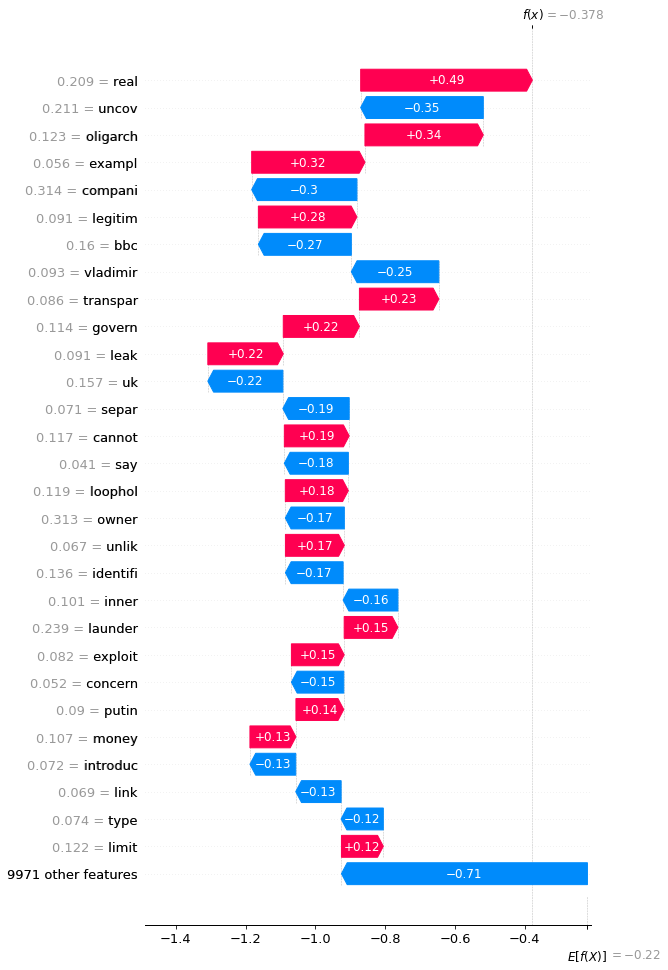

In [ ]:
ub.viz_opinion()

In [ ]:
ub.generate_tweet()

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
ub.predict_tweet_virality()

NameError: ignored

In [ ]:
ub.viz_virality()

## **eg two**

In [ ]:
tr_art=('''The latest target for President Donald Trump’s vitriol isn’t Joe Biden or Nancy Pelosi or the media. It’s the man who runs an eponymous website of links.
Yes, Matt Drudge’s “Drudge Report” is more than just a “website of links.”  Since the Bill Clinton impeachment in the late 1990s, the simplistic page has served as a sort of front page for the political world — driving scads of traffic to at-times obscure stories (or publications) that Drudge highlights.
For Trump, Drudge has always been a critical touchstone. During his rise in the 2016 Republican primaries, Trump not only regularly touted stories he found on the Drudge Report but also cited Drudge’s post-debate polls, which are not even close to scientifically conducted, as evidence that he had performed best.
So pro-Trump was Drudge considered during the 2016 primary that Sen. Ted Cruz of Texas referred to the webpage as an “attack site for the Donald Trump campaign.”
And Drudge’s coverage of Trump in the general election was as laudatory as his coverage of Hillary Clinton, long a Drudge nemesis, was negative. 
When Trump got to the White House, he didn’t forget Drudge: The two men met in the Oval Office in early 2017, according to Politico.
All of which makes Trump’s recent attacks on Drudge fascinating.
“Our people have all left Drudge,” Trump tweeted on Monday. “He is a confused MESS, has no clue what happened. Down 51%. @DRUDGE They like REVOLVER and others.”
(It’s not clear where Trump got the numbers on Drudge’s alleged traffic, although there is some evidence that Drudge’s ability to drive page views is decreasing.)
“Drudge didn’t support me in 2016, and I hear he doesn’t support me now,” Trump tweeted earlier this month in a blatant rewriting of history.''')

In [ ]:
tr=ArticleAnalyser(tr_art)

All model checkpoint layers were used when initializing TFT5ForConditionalGeneration.

All the layers of TFT5ForConditionalGeneration were initialized from the model checkpoint at t5-small.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFT5ForConditionalGeneration for predictions without further training.
All model checkpoint layers were used when initializing TFT5ForConditionalGeneration.

All the layers of TFT5ForConditionalGeneration were initialized from the model checkpoint at t5-small.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFT5ForConditionalGeneration for predictions without further training.
This tokenizer was incorrectly instantiated with a model max length of 512 which will be corrected in Transformers v5.
For now, this behavior is kept to avoid breaking backwards compatibility when padding/encoding with `truncation is True`.
- Be aware that you SHOULD NOT rely o

In [ ]:
tr.generate_headline()

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
tr.opinion_news_score()

Opinion Score = 9.82 percent


This will take a minute or two to generate...
Red pointers indicate word that suggest an opinion piece. The bigger the pointer, the more indicative it is of an opinion piece.
Blue pointers indicate word that suggest a news piece. The bigger the pointer, the more indicative the word is of a news piece.
Working from the bottom up, the plot shows how much each word influences the final prediction score.
Negative numbers suggest news pieces, positive numbers opinion pieces, so a final negative score suggests a news piece.


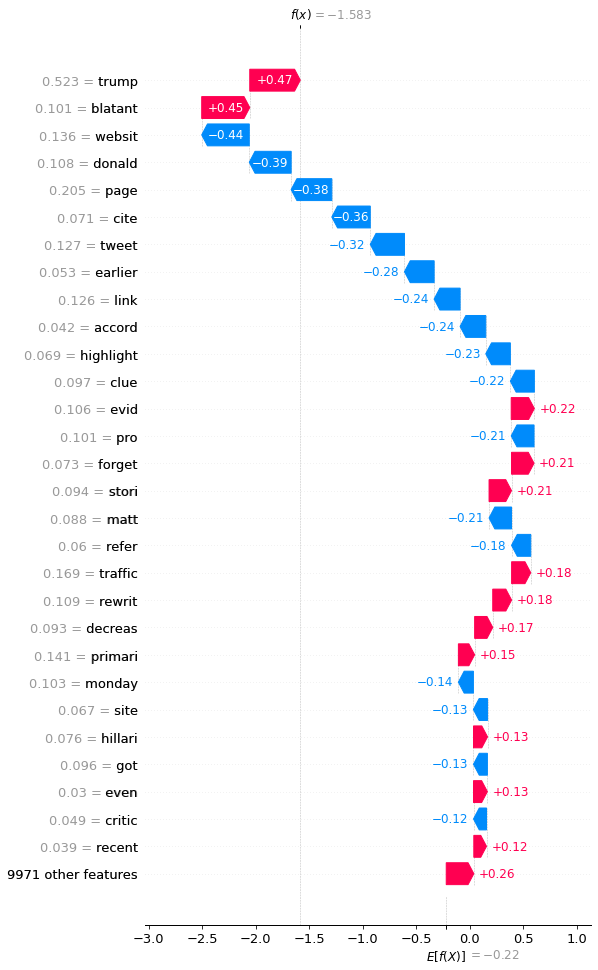

In [ ]:
tr.viz_opinion()

In [ ]:
tr.generate_tweet()

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
tr.predict_tweet_virality()

use generate_tweet method to generate the tweet


## **eg 3**

In [ ]:
apple_art=('''The jury in the Mark Duggan inquest has been offered counselling after its members were threatened and verbally abused in court.

Family members and friends of the 29-year-old, who was shot dead by an armed police officer, reacted with fury after jurors returned a verdict of “lawful killing”.

Mr Duggan was killed in Ferry Lane, Tottenham, on August 4, 2011, after the minicab he was travelling was stopped as part of an operation to tackle gun crime.

His death sparked riots in Tottenham and across England.

A statement issued on behalf of the Mark Duggan inquest said: "Judge Cutler has ordered that jurors and protected witnesses remain anonymous until a further order is made.

“The jury have been offered counselling by Barnet coroners court, this is routinely offered to juror's dealing with distressing and sensitive material.

“The jury has the inquest teams contact details if they have any queries or concerns.

Immediately after the jury forewoman announced the decision, on Wednesday afternoon, people in the public gallery rose to their feet and started screaming and shouting at jury.

Jurors, who were quickly rushed out of the room, were known only by a number and the coroner, Judge Keith Cutler, decided at the start of the inquest that they should have anonymity.

The day after the chaotic and angry scenes in the inquest court room, at the Royal Courts of Justice, in central London, the coroner made a ruling continuing the anonymity for the ten jury members and for witnesses whose names were not revealed in court.

Those witnesses include the officer who fired the fatal shot and other officers involved in the operation.''')

In [ ]:
apple=ArticleAnalyser(apple_art)

All model checkpoint layers were used when initializing TFT5ForConditionalGeneration.

All the layers of TFT5ForConditionalGeneration were initialized from the model checkpoint at t5-small.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFT5ForConditionalGeneration for predictions without further training.
All model checkpoint layers were used when initializing TFT5ForConditionalGeneration.

All the layers of TFT5ForConditionalGeneration were initialized from the model checkpoint at t5-small.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFT5ForConditionalGeneration for predictions without further training.
This tokenizer was incorrectly instantiated with a model max length of 512 which will be corrected in Transformers v5.
For now, this behavior is kept to avoid breaking backwards compatibility when padding/encoding with `truncation is True`.
- Be aware that you SHOULD NOT rely o

In [ ]:
apple.generate_headline()

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
apple.opinion_news_score()

Opinion Score = 1.97 percent


In [ ]:
apple.show_vocab_vectors('bbc')

Output hidden; open in https://colab.research.google.com to view.

2015 count 3
2016 count 1
2017 count 2
2018 count 0
2019 count 4
2020 count 49924
2021 count 11358
2022 count 710


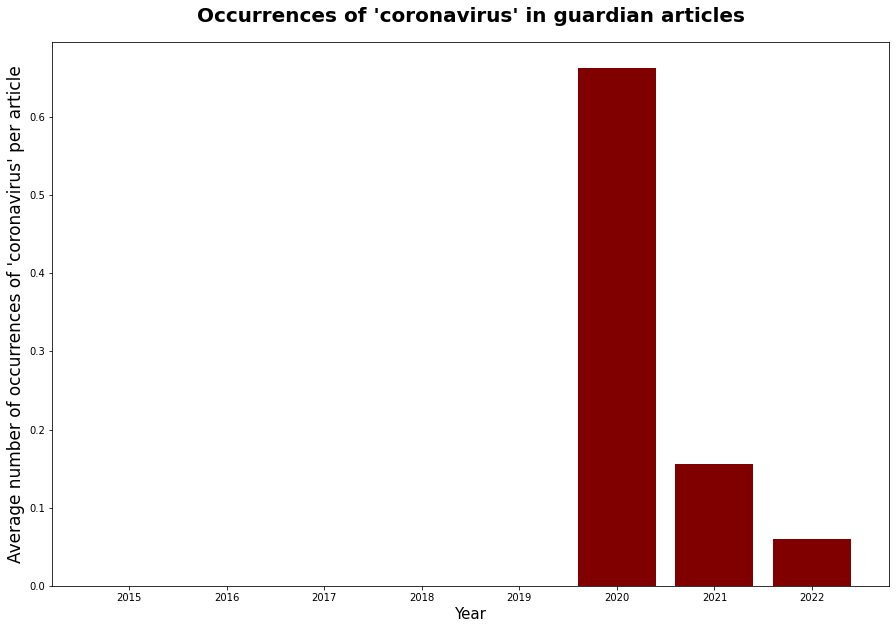

In [ ]:
apple.make_word_time_fig('coronavirus', 'guardian')